# Introduction

This work will focus on classifying images using deep learning method, CNN in particular. The aim of the this excercise is to use transfer learning techniques to help us identify / label the type of room it is in a picture. This will help us identify the user and see the photo of room of their interest without flipping through other less relevant photos.

This notebook was trained running on FloydHub using K80 GPU.

# Library import

I have tried Keras which is easy to use, however, recently I have found fastai to be more effective in constructing DL models.

In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

In [3]:
from fastai.vision import *
from fastai.metrics import error_rate, accuracy
from fastai.widgets import *

# Image source

I have scrapped regional property photo from Zoopla and semi-manually labelling the photos to be the below categories. All the images were scrapped using python Scrapy. The images were manually labelled in batches. The process looks like this:

1. Manually label 100 images
1. Train a classifier based on 100 images
1. Predict the images for the next 100 images
1. Manually identify the errors and go to step 2
1. Until all images were labelled (2.7K images)

In [4]:
data_dir='/floyd/input/property_images/train'
folder = os.listdir(data_dir)
folder

['living',
 'bedroom',
 'plans',
 'kitchen',
 'conservatory',
 'kitchen_diner',
 'dinning',
 'corridor',
 'balcony',
 'garden',
 '.ipynb_checkpoints',
 'classification',
 'exterior',
 'bathroom',
 'views']

# Data Preparation

In order to have a fixed set of train and validation dataset, I need to fix the random seed that generates the sequence.

The transformation method is held to be shared between training and inference stage, so any image input will go through exactly the same transformation.

In [6]:
np.random.seed(2019)
trsf = get_transforms(do_flip=True,flip_vert=False, max_rotate=60, max_lighting=0.1, max_zoom=1.05)

Here I am importing the images based on a CSV file, which contains the file location and its label. The original photos were labelled in folder, however, I found that there are some errors in the manual label. Hence I have created a CSV file that sits on top of the existing folder structure to correct the labels.

After importing the images, one important action is to normalize the images, so that the images have a sharper gradient to learn for the neural network. It also uses the normalization stats of the imagenet dataset to be consistent.

In [7]:
data = ImageDataBunch.from_csv('/floyd/input/property_images/train',
                               csv_labels='/floyd/home/cleaned.csv',
                               valid_pct=0.2,
                               size=64,bs=2048,
                               ds_tfms=trsf,
                               num_workers=0).normalize(imagenet_stats)

In [8]:
len(data.train_ds)

2063

In [9]:
len(data.valid_ds)

515

Checking the batch of data that will go into training

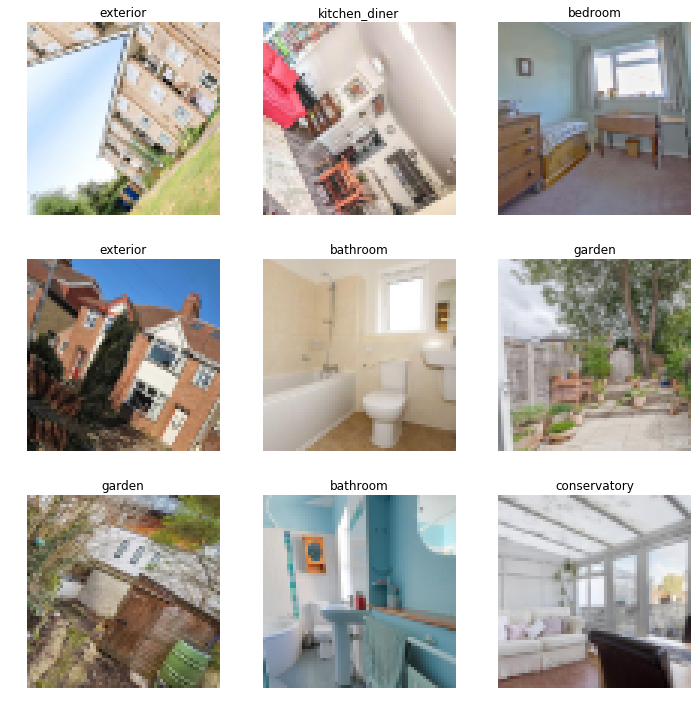

In [7]:
data.show_batch(rows=3, figsize=(10, 10))

# Training CNN model

Using ResNet34 which is the smallest ResNet available. ResNet is a CNN architecture which allow the raw image input to skip several layers to improve the gradient during the training process. Since a standard CNN can be quite hard to converge because of the number of layers involved, in the case of ResNet34, it has 34 layers. Any error calculated at the top layer is really hard to backpropagate to the bottom layers. Hence ResNet addressed this by introducing skipping connections.

cnn_learner here will create a CNN architecture that looks like ResNet34 and use the pretrained weighting as the starting point of this traning. This will allow us gaining the benefit of the vast availability of imagenet dataset.

In [7]:
learn = cnn_learner(data, models.resnet34, metrics=accuracy, path='/floyd/home/')#, loss_func=MyCrossEntropy())

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.torch/models/resnet34-333f7ec4.pth
87306240it [00:01, 57159759.44it/s]


Here we are using transfer learning technique. By using learn.freeze(), we are freezing the bottom layers of the ResNet34 during the training. This allow us to train the top dense layers to recognize / label the rooms based on the raw imagenet pretrained weighting. It has two major benefits:

1. Smaller set of parameters to tune: Since we are only backpropagate the errors to the top two dense layers.
1. Better accuracy: Since we haven't got a good model at the beginning, it will confuse the feature generating bottom layers if we backpropagate the errors straight away.

The fit_one_cycle method will vary the learning_rate during the training. It will start with a small learning rate, and ramp up the learning rate, then decrease the learning rate to help find a global minimum instead of a local minimum. The idea is very similar to random stochastic process which gradually cools down the randomness to avoid local minimum.

In [9]:
learn.freeze()
learn.fit_one_cycle(10)

epoch,train_loss,valid_loss,accuracy,time
0,3.180825,3.311295,0.034951,00:57
1,3.170609,2.791423,0.075728,00:41
2,3.084767,2.187810,0.306796,00:41
3,2.944134,1.770882,0.446602,00:41
4,2.791332,1.562907,0.504854,00:41
5,2.639190,1.463272,0.530097,00:42
6,2.505147,1.403732,0.549515,00:42
7,2.396892,1.366768,0.565049,00:41
8,2.313414,1.343123,0.568932,00:42
9,2.238356,1.330943,0.582524,00:42


As we can see above, the accuracy has improved from 3% to 58% after learning the full dataset 10 times.

We can see that the train_loss is way higher than valid_loss, this means we are underfitting our dataset. Hence we will need to fit a few more rounds.

In [16]:
learn.fit_one_cycle(10)

epoch,train_loss,valid_loss,accuracy,time
0,1.619313,1.321879,0.588350,00:42
1,1.625431,1.302127,0.596117,00:42
2,1.611377,1.268868,0.607767,00:41
3,1.592176,1.233304,0.617476,00:42
4,1.564438,1.202868,0.623301,00:42
5,1.548237,1.178558,0.625243,00:42
6,1.527684,1.159365,0.631068,00:41
7,1.508325,1.148475,0.634951,00:42
8,1.487274,1.145026,0.631068,00:42
9,1.470797,1.146551,0.631068,00:42


Next, let's find out where is the best learning rate for improving the accuracy. The lr_find function will use various learning rate and check the train_loss as the learning rate gradually increases.

In [17]:
learn.save('stage-4-.98')

In [10]:
_ = learn.load('stage-1-64')

Here we are unfreezing the bottom layers to customize the bottom layers to start recognizing our rooms rather than images in the imagenet database.

In [12]:
learn.unfreeze()
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,accuracy,time
0,1.337616,1.141319,0.634951,01:02
1,1.343014,1.083710,0.633010,00:41
2,1.279354,1.062684,0.652427,00:41
3,1.222914,1.052774,0.667961,00:40


The accuracy is improving over the iterations, and the train_loss is still higher than valid_loss hence we are underfitting our data. 

In [14]:
learn.fit_one_cycle(5)

epoch,train_loss,valid_loss,accuracy,time
0,1.028444,1.033764,0.667961,00:42
1,1.007265,0.991030,0.695146,00:42
2,0.982655,0.964058,0.691262,00:41
3,0.951849,0.939427,0.687379,00:42
4,0.923496,0.915629,0.699029,00:42


# Transfer learning

Since we haven't gained much in terms accuracy, 70% mark maybe the best that we are able to achieve for 64x64 images. Let's improve the image quality to 128x128 and see if it improves the accuracy.

In [8]:
data = ImageDataBunch.from_csv('/floyd/input/property_images/train',
                               csv_labels='/floyd/home/cleaned.csv',
                               valid_pct=0.2,
                               size=128,bs=512,
                               ds_tfms=trsf,
                               num_workers=0).normalize(imagenet_stats)

In [14]:
learn.data = data

In [18]:
learn.fit_one_cycle(10)

epoch,train_loss,valid_loss,accuracy,time
0,0.988313,0.895583,0.652427,00:59
1,0.959993,0.697232,0.753398,00:56
2,0.926232,0.599690,0.788350,00:55
3,0.892474,0.567574,0.786408,00:54
4,0.862911,0.563657,0.786408,00:55
5,0.837078,0.543068,0.801942,00:55
6,0.818470,0.530229,0.803883,00:56
7,0.800536,0.524092,0.801942,00:55
8,0.783518,0.520911,0.803883,00:54
9,0.767943,0.519511,0.809709,00:56


In [19]:
learn.save('stage-1-128')

In [11]:
_ = learn.load('stage-1-128')

By improving the image quality, we have successfully improved the accuracy from 70% to 80%. For the next step, I will analyze the different learning rate and find the best learning range that will reduce the training loss.

By using the lr_find function, it will start from small learning rate and gradually increase it to really large learning rate which will cause the training loss to overshoot towards the end. The reason being the original solution was closer to the optimal solution but being pushed out by the large learning rate.

[Original paper](https://arxiv.org/pdf/1506.01186.pdf)

In [12]:
learn.unfreeze()
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.20E-03


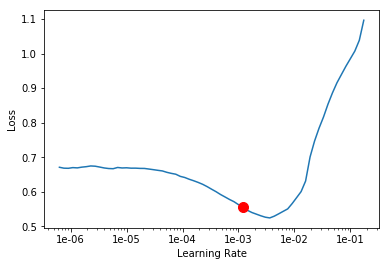

In [13]:
learn.recorder.plot(suggestion=True)

The optimal LR is the region where it has the steepest drops. The drop means the biggest decrease can be achieved through few training cycles. Hence this is the optimal level of learning rate, since it provides the best return on training, in this case it suggested 0.0012.

In [14]:
learn.fit_one_cycle(5, max_lr=slice(1e-5, 1e-3))

epoch,train_loss,valid_loss,accuracy,time
0,0.671530,0.481585,0.827184,01:01
1,0.652895,0.482122,0.831068,01:00
2,0.623740,0.468328,0.840777,01:00
3,0.585093,0.454938,0.850485,00:59
4,0.565827,0.449319,0.846602,00:59


In [15]:
learn.fit_one_cycle(5, max_lr=slice(3e-4))

epoch,train_loss,valid_loss,accuracy,time
0,0.487908,0.446590,0.850485,01:00
1,0.479150,0.440458,0.854369,00:59
2,0.469277,0.437849,0.854369,00:58
3,0.457317,0.437613,0.856311,00:59
4,0.450846,0.437940,0.854369,00:59


In [16]:
learn.fit_one_cycle(5, max_lr=slice(3e-4))

epoch,train_loss,valid_loss,accuracy,time
0,0.430268,0.437106,0.856311,01:00
1,0.415312,0.432603,0.862136,00:59
2,0.410294,0.431258,0.862136,00:59
3,0.406446,0.429709,0.862136,00:59
4,0.402146,0.428590,0.860194,00:59


We can see from the loss chart below, our training loss is still a lot higher than our validation loss. hence more training is required.

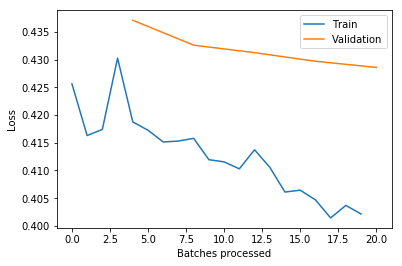

In [17]:
learn.recorder.plot_losses()

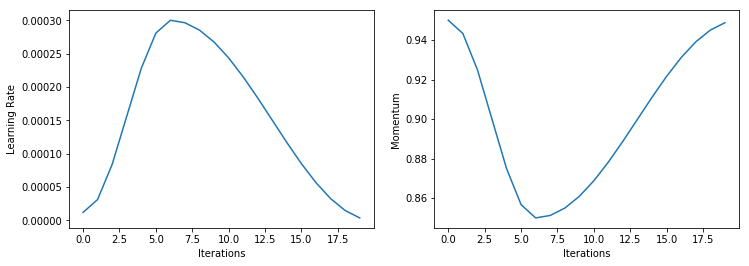

In [18]:
learn.recorder.plot_lr(show_moms=True)

As we can see below, the algorithm has got most of them correct.

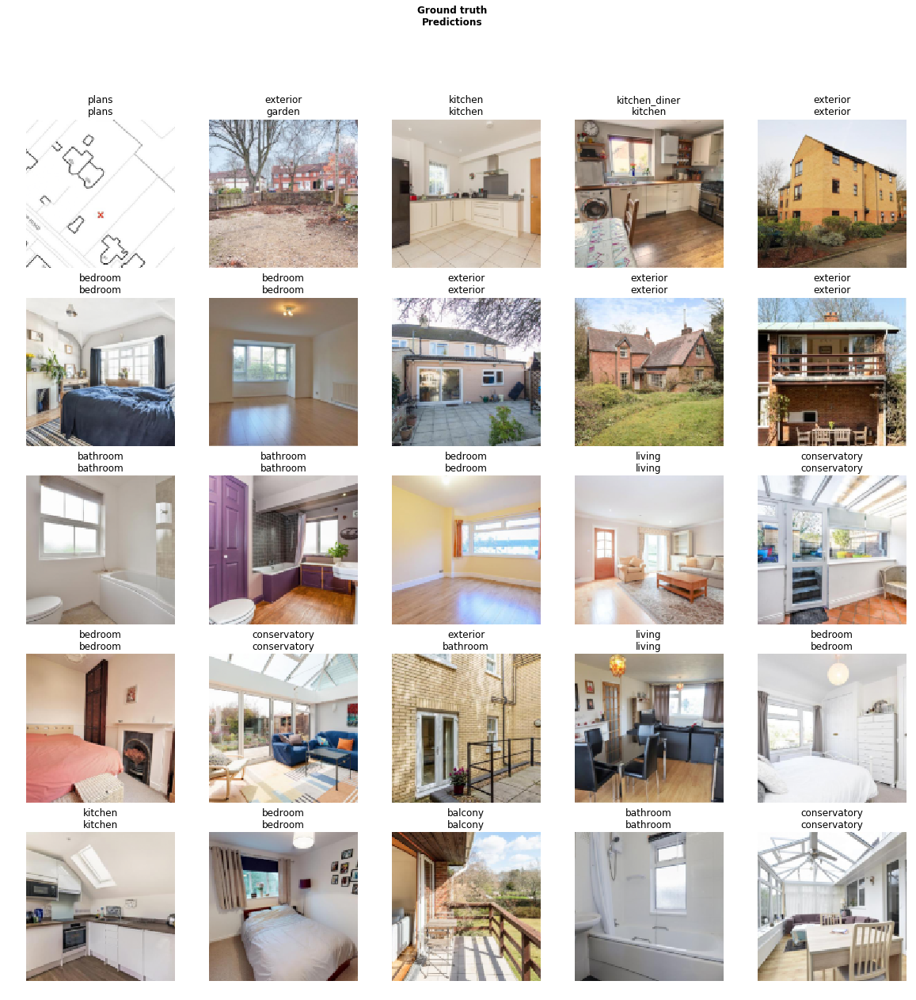

In [19]:
learn.show_results()

In [20]:
learn.save('stage-2-128')

Continue the increase in picture size

In [21]:
data = ImageDataBunch.from_csv('/floyd/input/property_images/train',
                               csv_labels='/floyd/home/cleaned.csv',
                               valid_pct=0.2,
                               size=256,bs=256,
                               ds_tfms=trsf,
                               num_workers=0).normalize(imagenet_stats)

In [22]:
learn.data = data

In [23]:
learn.freeze()
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,accuracy,time
0,0.561566,0.368939,0.877670,01:27
1,0.518282,0.320388,0.885437,01:18
2,0.492139,0.304931,0.881553,01:19
3,0.463422,0.304793,0.887379,01:19


In [24]:
learn.fit_one_cycle(5)

epoch,train_loss,valid_loss,accuracy,time
0,0.388723,0.302652,0.885437,01:20
1,0.382099,0.295559,0.879612,01:19
2,0.369912,0.296245,0.891262,01:21
3,0.359480,0.300031,0.899029,01:20
4,0.347980,0.297883,0.897087,01:19


In [25]:
learn.unfreeze()
learn.lr_find(end_lr=1e-2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.98E-04


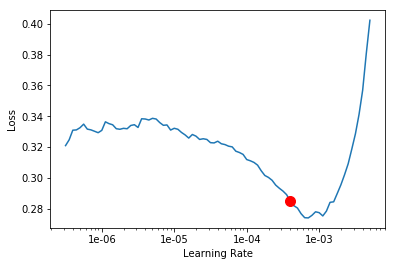

In [26]:
learn.recorder.plot(suggestion=True)

In this chart for LR discovery, the suggested area may have the biggest gradient, but the global minimum of the loss is around 0.001. As a general rule of thumb, the best area is roughly 10 times smaller than it, hence 0.0001.

In [27]:
learn.unfreeze()
learn.fit_one_cycle(10, max_lr=slice(3e-6, 1e-4))

epoch,train_loss,valid_loss,accuracy,time
0,0.336481,0.298102,0.897087,01:27
1,0.333721,0.295720,0.895146,01:27
2,0.326987,0.285720,0.895146,01:27
3,0.319136,0.291134,0.895146,01:26
4,0.310797,0.297506,0.897087,01:27
5,0.303005,0.289062,0.891262,01:26
6,0.294463,0.283891,0.893204,01:27
7,0.288944,0.282322,0.895146,01:28
8,0.283087,0.281388,0.897087,01:28
9,0.275578,0.282097,0.895146,01:27


In [28]:
learn.fit_one_cycle(1, max_lr=slice(3e-4))

epoch,train_loss,valid_loss,accuracy,time
0,0.253457,0.285631,0.895146,01:28


The accuracy has not improved over the training, now try to reduce the batch size to reduce training too broadly for each batch.

In [29]:
learn.save('stage-2-256')

In [6]:
data = ImageDataBunch.from_csv('/floyd/input/property_images/train',
                               csv_labels='/floyd/home/cleaned.csv',
                               valid_pct=0.2,
                               size=256,bs=64,
                               ds_tfms=trsf,
                               num_workers=0).normalize(imagenet_stats)

In [50]:
learn.data = data

In [32]:
learn.freeze()
learn.fit_one_cycle(1)

epoch,train_loss,valid_loss,accuracy,time
0,0.339547,0.159377,0.943689,01:21


In [35]:
learn.freeze()
learn.lr_find(end_lr=1e-2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.98E-07


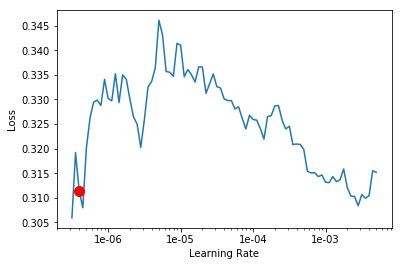

In [36]:
learn.recorder.plot(suggestion=True)

In [37]:
learn.fit_one_cycle(5, max_lr=slice(1e-5, 3e-4))

epoch,train_loss,valid_loss,accuracy,time
0,0.325683,0.150427,0.945631,01:21
1,0.312461,0.142907,0.955340,01:21
2,0.309469,0.143094,0.955340,01:22
3,0.307541,0.142295,0.955340,01:21
4,0.298029,0.141328,0.955340,01:20


In [38]:
learn.save('stage-1-256')

In [39]:
learn.unfreeze()
learn.lr_find(end_lr=1e-2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 1.41E-06


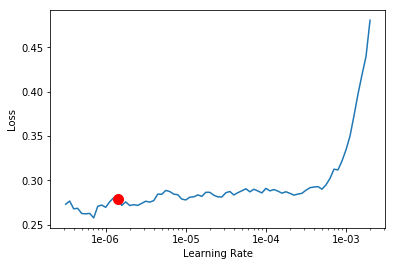

In [40]:
learn.recorder.plot(suggestion=True)

In [41]:
learn.fit_one_cycle(2, max_lr=slice(3e-7))

epoch,train_loss,valid_loss,accuracy,time
0,0.276341,0.142657,0.955340,01:28
1,0.276910,0.143939,0.957282,01:27


In [42]:
learn.save('stage-2-256')

In [45]:
_ = learn.load('stage-2-256')

In [51]:
learn.freeze()
learn.fit_one_cycle(1)

epoch,train_loss,valid_loss,accuracy,time
0,0.305686,0.154410,0.941748,01:21


In [52]:
learn.freeze()
learn.lr_find(end_lr=1e-2)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 3.98E-07


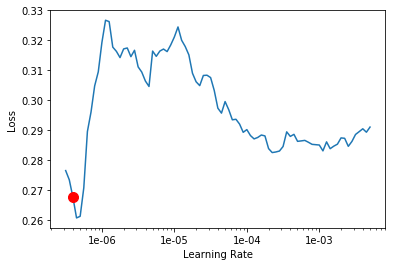

In [53]:
learn.recorder.plot(suggestion=True)

In [54]:
learn.fit_one_cycle(5, max_lr=slice(2e-6, 3e-5))

epoch,train_loss,valid_loss,accuracy,time
0,0.300822,0.157671,0.939806,01:21
1,0.298427,0.149351,0.945631,01:20
2,0.294275,0.143313,0.957282,01:22
3,0.295208,0.144609,0.953398,01:22
4,0.289841,0.141603,0.959223,01:21


In [55]:
learn.fit_one_cycle(5, max_lr=slice(3e-5))

epoch,train_loss,valid_loss,accuracy,time
0,0.276122,0.146090,0.953398,01:17
1,0.298145,0.141115,0.953398,01:20
2,0.294795,0.139679,0.957282,01:20
3,0.292396,0.137649,0.957282,01:20
4,0.294283,0.139766,0.959223,01:17


In [56]:
learn.fit_one_cycle(20, max_lr=slice(3e-5))

epoch,train_loss,valid_loss,accuracy,time
0,0.285057,0.140548,0.955340,01:21
1,0.294167,0.138379,0.957282,01:21
2,0.281886,0.138792,0.959223,01:21
3,0.274823,0.135347,0.963107,01:22
4,0.263835,0.134783,0.963107,01:22
5,0.268129,0.136395,0.959223,01:21
6,0.265507,0.136588,0.957282,01:20
7,0.266932,0.134723,0.961165,01:22
8,0.276203,0.136463,0.961165,01:21
9,0.273921,0.135802,0.957282,01:20


In [57]:
learn.save('stage-3-256')

Training metric accuracy has stopped improving even as the number of batches increases. I suspect this is due to the quality of the original dataset.

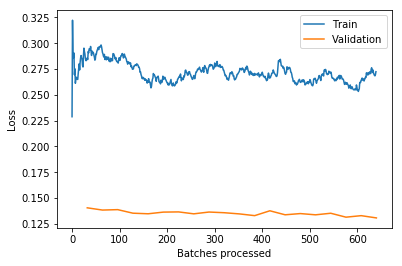

In [58]:
learn.recorder.plot_losses()

In [9]:
_ = learn.load('stage-3-256')

# Result analysis

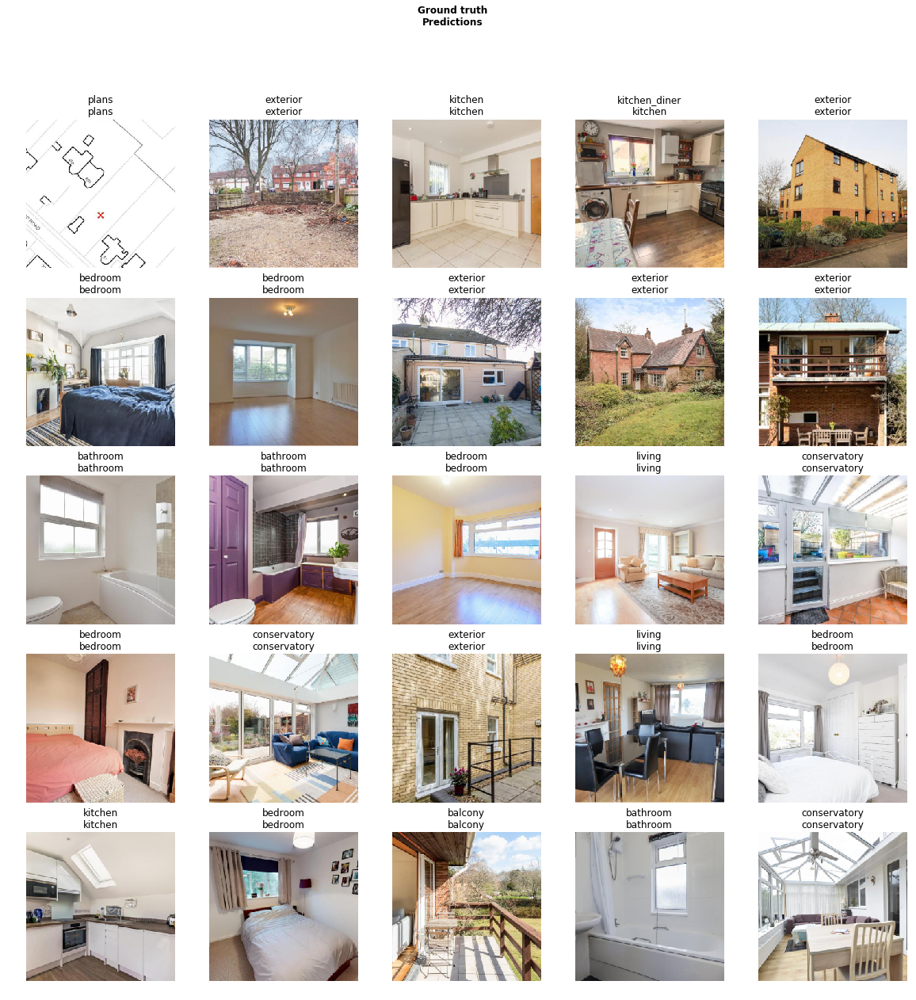

In [10]:
learn.show_results()

The best way to check the classifiation errors is using confusion matrix, this allows us to gain an intuitive feel of how many images were miss classified.

From the confusion matrix, we can see that our training set has a very imbalanced training images for different classes, the exterior and bedroom class are the mostly trained classes, where as the plans, balcony, views, and corridor were the least trained classes. This is simply because in the original data gathering process, we only taken into account the number of images as a whole training set without much consideration into the balance of different classes.

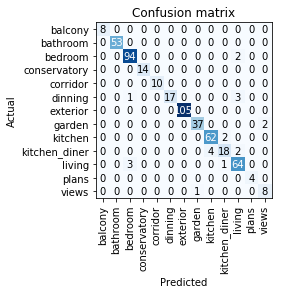

In [11]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In order to allow the machine explain itself what it think it's import, we can use a headmap that represents the activation region that triggers the classification.

If the features that it identifies in an image is around the features we think are important for classification, it means the CNN has found the correct area. Otherwise it means CNN was looking at the completely wrong area of interest. Which could mean that this is a very good training data to keep in the next training set.

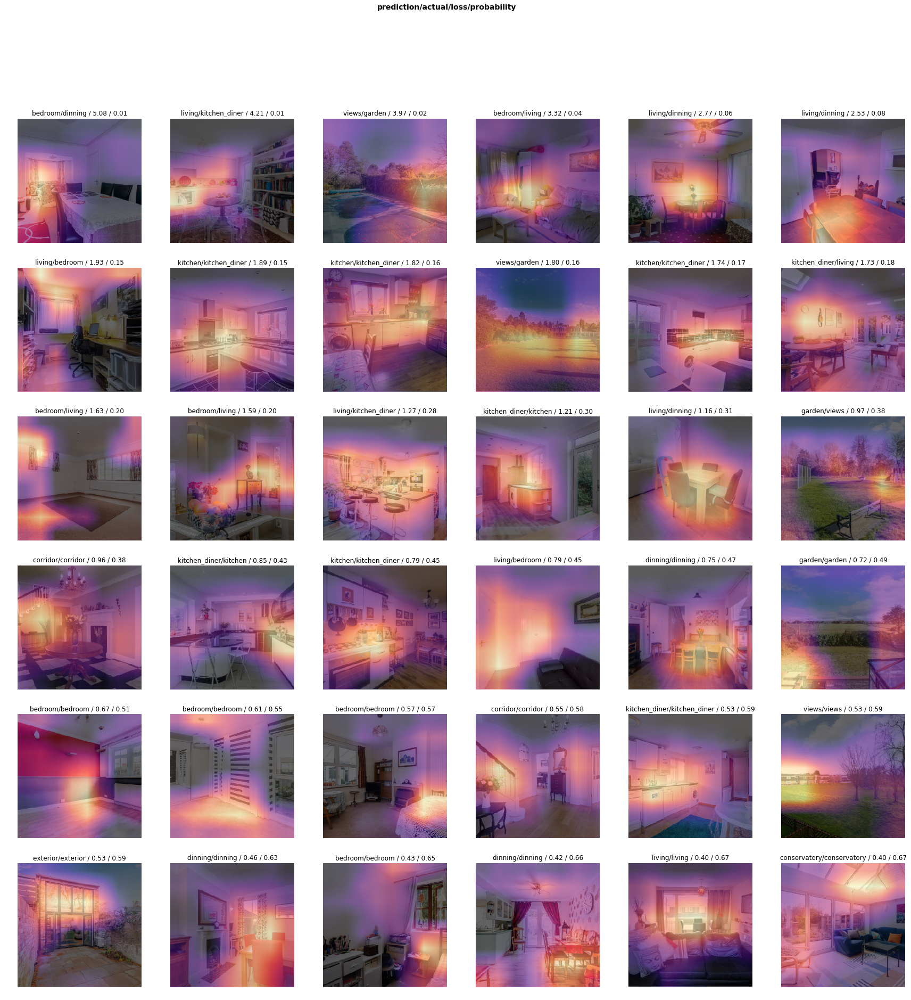

In [12]:
interp.plot_top_losses(36, figsize=(30,30))

In [13]:
learn.export()

In [8]:
learn = load_learner('.')

# Inference on new data

We have looked at the already labelled data, and it has got a pretty good result in terms of accuracy. Let validate it against some unseen test data.

The images were stored in a different folder compared to the training set. Hence we can import this using the from_folder method.

In [9]:
data = ImageDataBunch.from_folder('/floyd/input/property_images/train',
                                  test='/floyd/input/property_images/test',
                                  valid_pct=0.2,
                                  ds_tfms=trsf,
                                  size=224,bs=256,
                                  num_workers=0).normalize(imagenet_stats)

In [10]:
learn.data = data

Predicting the entire test set

In [11]:
preds, y, loss = learn.get_preds(ds_type=DatasetType.Test, with_loss=True)

Checking the classes that are available

In [12]:
data.classes

['balcony',
 'bathroom',
 'bedroom',
 'conservatory',
 'corridor',
 'dinning',
 'exterior',
 'garden',
 'kitchen',
 'kitchen_diner',
 'living',
 'plans',
 'views']

preds is a PyTorch datatype tensor, max function will find the maximum value and its corresponding index along axis 1 which is the different classes for each image

In [13]:
values, indices = preds.max(1)

Images that it has identified under each class and their counts

In [14]:
pred_labels = pd.Series([data.classes[x] for x in indices])
pred_labels.value_counts()

bedroom          3981
exterior         2846
living           2578
bathroom         1677
kitchen          1669
garden           1667
dinning           570
kitchen_diner     522
corridor          330
conservatory      168
views             161
balcony           120
plans             101
dtype: int64

Plot the actual results from the last 20 images in each class

In [15]:
def show_cat_images(name):
    rows = 4
    cols = 5
    fig, ax = plt.subplots(rows, cols, figsize=(20, 15))
    index = pred_labels[pred_labels==name][-20:].index
    for r in range(rows):
        for c in range(cols):
            idx = index[r * cols + c]
            show_image(data.test_ds[idx][0], ax=ax[r][c])
            ax[r][c].set_title(name)

## Analysis

**Balcony**: This class only has 8 images, in the training set, but it has identified 16 out of 20 images correctly in the test set. This is quite an achievement considering the amount of training data it has. 16/20 correct

**Bathroom**: The distinct features within bathroom probably made it the easies room to identify. 20/20 correct

**Bedroom**: This class is one of the most heavily trained classes within the training set. However, its built-in difficulty such as empty room / sofa within a bedroom all brings its own complications. The living room that was classified as bedroom was probably caused by the fact that we are only looking at a small transform and cropped image of the original image. A lot of the details were hard to identify even for human eyes. And the corridor that has been wrongly labelled as bedroom is probably caused by the fact that corridor class was not well trained due to lack of presence in the training set (10 images out of 2000). 16/20 correct

**Conservatory**: The CNN has correctly identified the strip pattern from the ceilings. Although it counted feature wooden bars in a living room and counted it as conservatory. Hence it needs further training. 15/20 correct

**Corridor**: It has identified that the staircase handrails are key features / indicator that this is a corridor. As well as many doors and a long path. There is a loft converted room which features handrails but it's actually a bedroom. This is another good training set. 17/20 correct

**Dinning**: The CNN seems to have grasped the idea that chairs with wooden bars are important features of a dinning room. One of the images were actually a corridor/staircase, which has similar features to a chair with wooden bars. 19/20 correct

**Plans**: This includes any documentation about the house and the floorplans. 20/20 correct

As we go along the rest of the dataset, we can see a pattern that the CNN that we have trained clearly demonstrated that the CNN has learnt a great deal of knowledge about each room. And even with limited amount of training it is able to identify a class with distinct features such as **plans** with high accuracy.

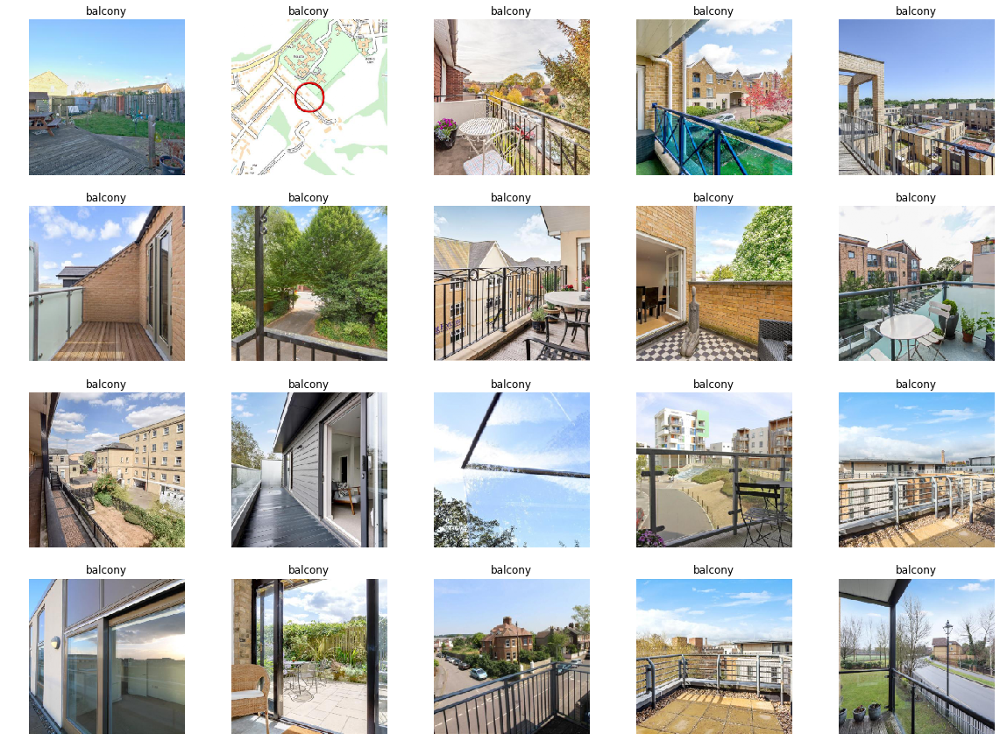

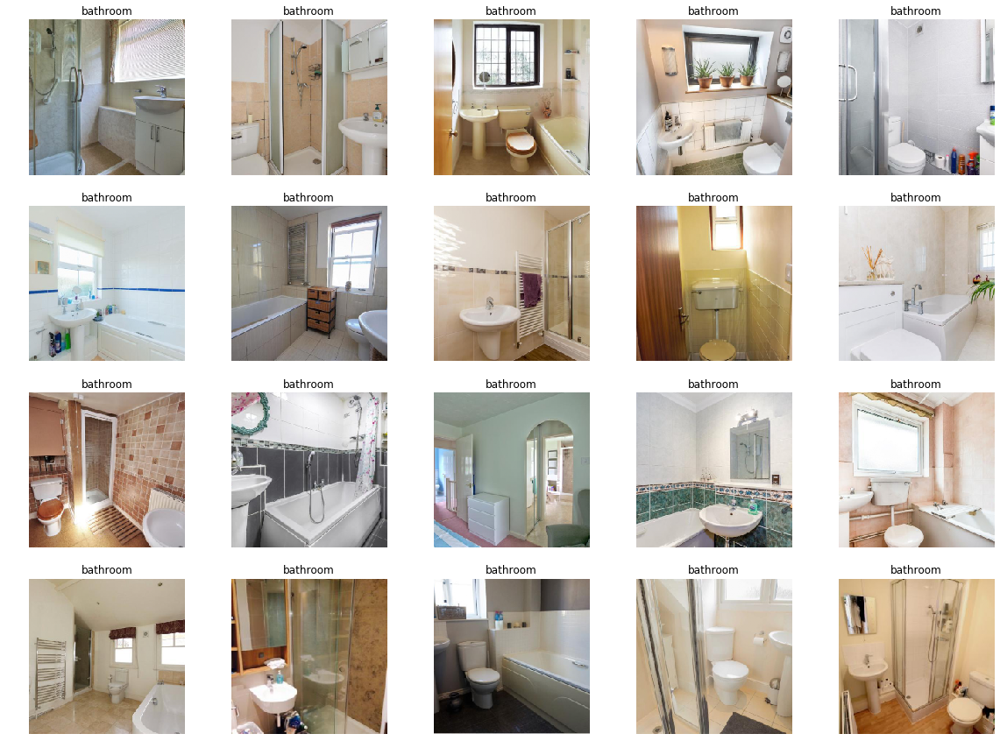

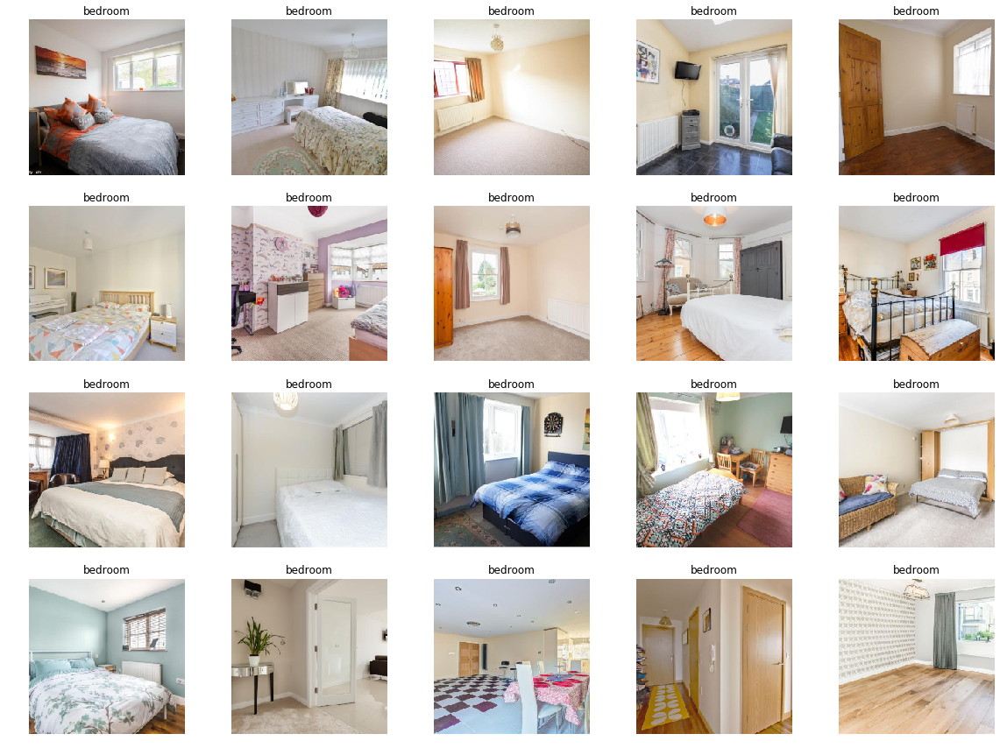

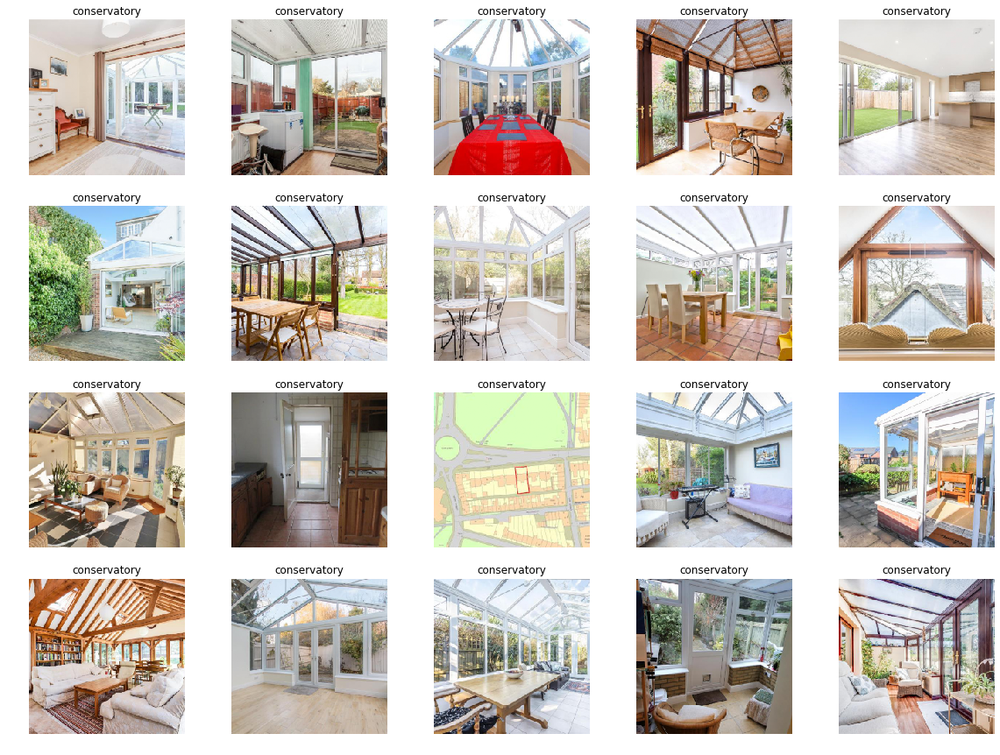

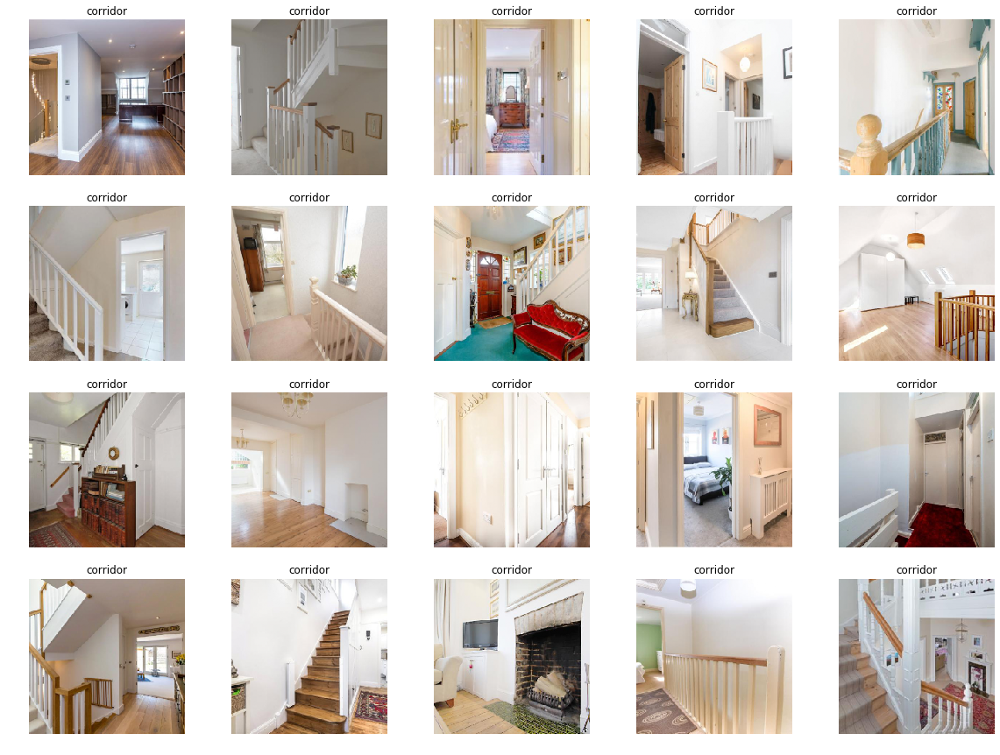

...

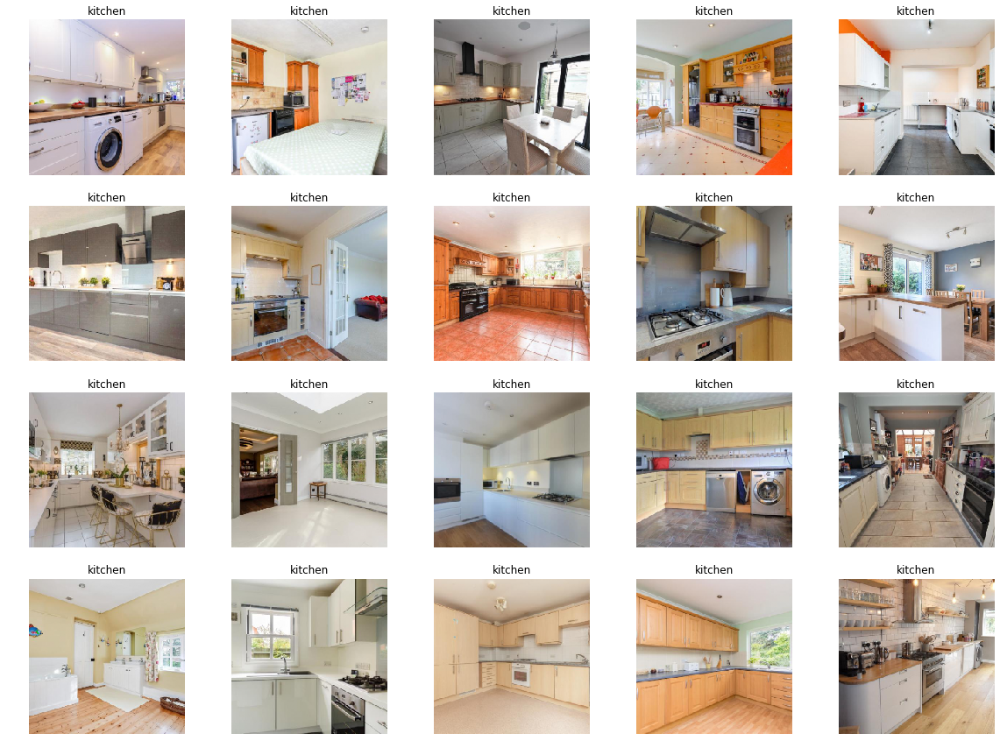

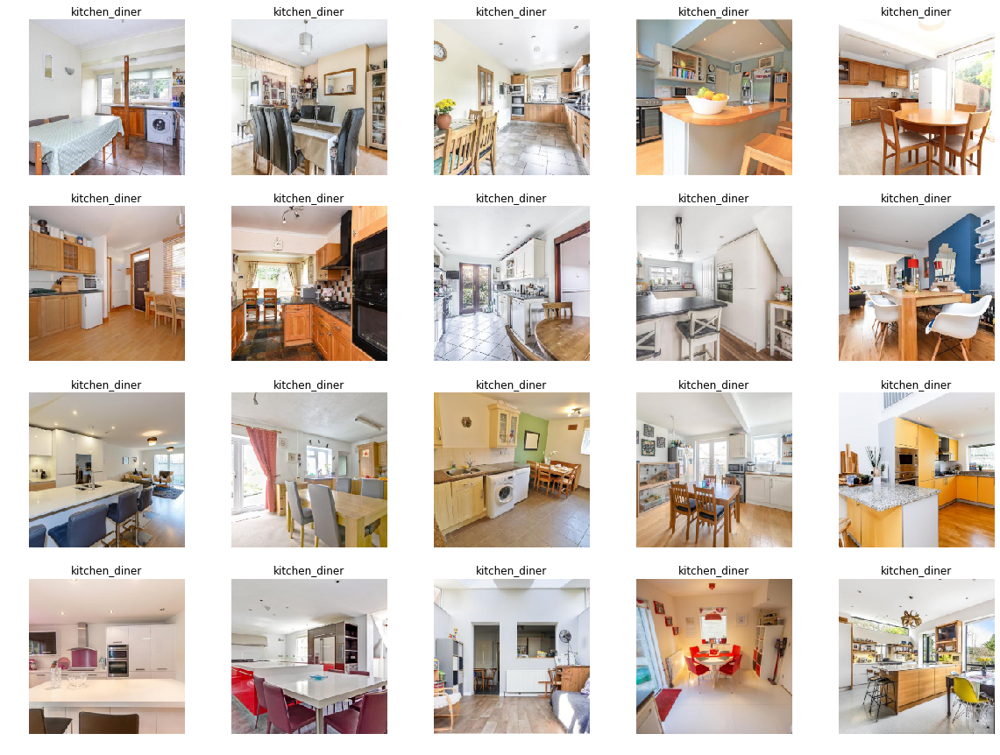

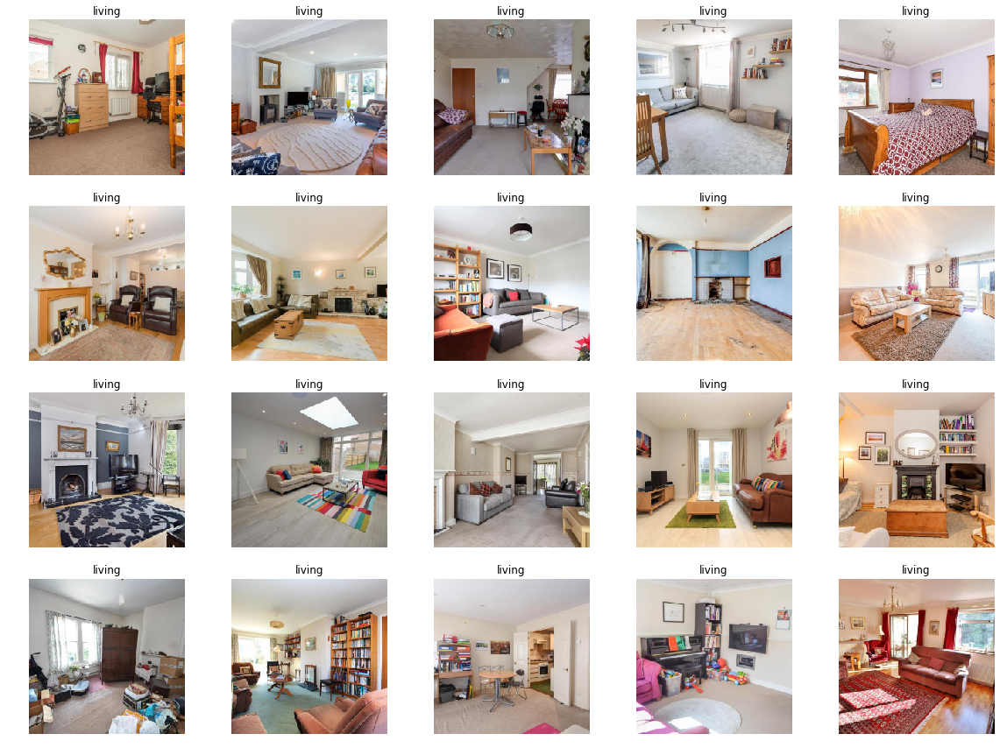

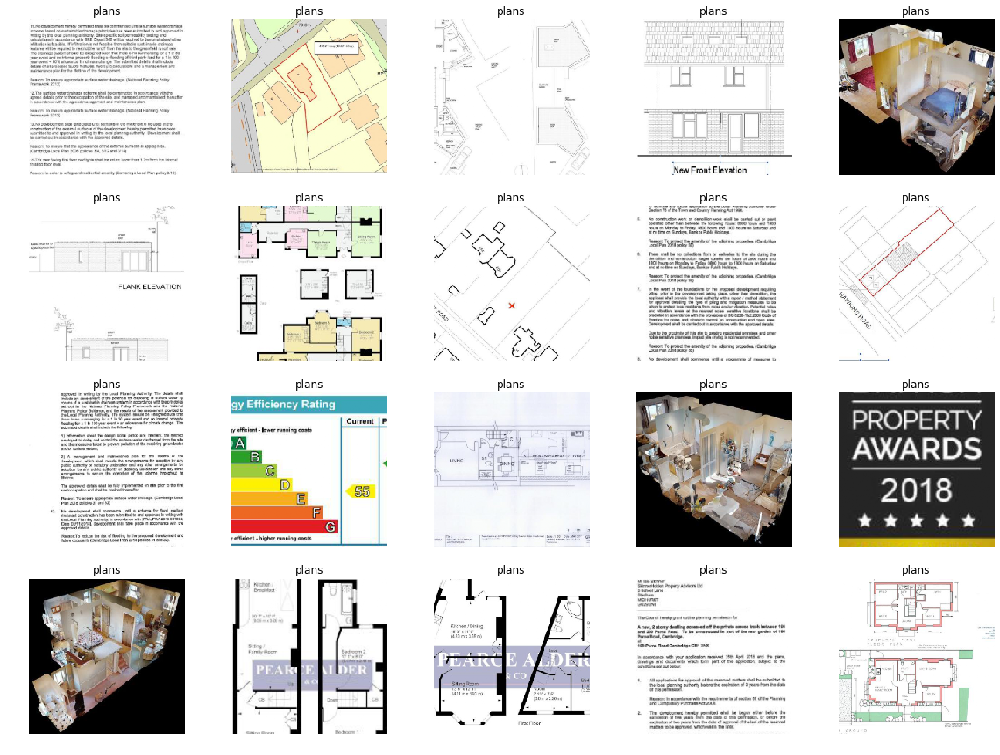

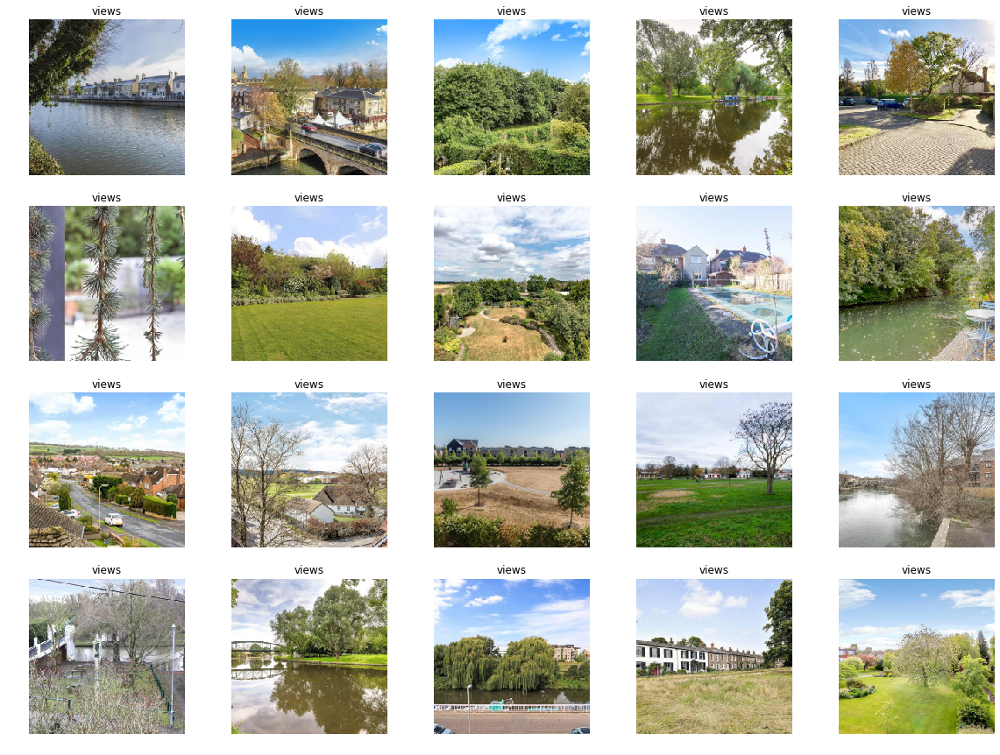

In [16]:
for c in data.classes:
    show_cat_images(c)

# Deployment

Since we have already created a CNN network, I think it would be useful to create an API for it. Hence I have created a docker image as well as a web app on google cloud platform to host this great network.

Repo: https://github.com/t2o2/room_classification

[Room Classifier GCP App](http://roomclassify.appspot.com)

# Future work

There are three major improvements can be done if given more time and MONEY, training costs money.

1. Improve the class imbalance in the training set. Currently the dataset is heavily imbalanced. The more edge cases in staircase, corridor, and balcony could all benefit from increasing the number of training images for these classes.
1. From the visual inspection on the unseen data, using accuracy as the metrics to watch is probably not the best parameter to use. Since we have a class level imbalance in the dataset, we maybe prediction correctly for the most common class but very accuracy for the rarer classes. I suggest we can either use F1 micro score or FBeta score to better indicate how we are performing in different classes. Although, by solving the first question will automatically address some concerns in this point.
1. Kitchen dinner and Kitchen class are very similar which is prone to misclassify as we can see in the confusion matrix.